# L98-59

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from glob import glob
import ombre as om
import numpy as np
import matplotlib.pyplot as plt

In [5]:
fnames = np.sort(glob('/Volumes/Nibelheim/hst/data/L98-59/ie320*.fits'))

In [9]:
obs = om.Observation.from_files(fnames, planets='b', limit=1)

Backward:   0%|                                                                        | 0/7 [00:00<?, ?it/s]


In [10]:
obs

L-98-59 [1 planets, 1 Visits]

In [11]:
obs.letter

array(['b'], dtype=object)

In [ ]:
# obs.period, obs.t0, obs.radius, obs.duration, obs.incl, obs.mass, obs.letter = obs.period[:-1], obs.t0[:-1], obs.radius[:-1], obs.duration[:-1], obs.incl[:-1], obs.mass[:-1], obs.letter[:-1]
# obs.nplanets = 3
# for idx in range(len(obs)):
#     obs[idx].nplanets = 3

In [15]:
import lightkurve as lk
import astropy.units as u

clc = lk.search_lightcurve('L98-59', author='SPOC', exptime=120).download_all().stitch().remove_nans()
clc.time += 2457000
#clc.flux_err = clc.fraw_err.value/clc.fraw.value

tmask = np.asarray([~clc.to_periodogram('bls', period=[p, p], duration=dur).get_transit_mask(period=p, duration=dur, transit_time=t0) for p, t0, dur in zip(obs.period, obs.t0, [2/24, 2/24, 2/24])]).all(axis=0)
clc = clc.flatten(21, mask=~tmask)

clc.flux = clc.flux.value * u.electron/u.s
clc.flux_err = clc.flux_err.value * u.electron/u.s

In [16]:
clc = lk.LightCurve(time=clc.time, flux=clc.flux, flux_err=clc.flux_err, time_format='jd')

<AxesSubplot:xlabel='Time - 2457000 [BTJD days]', ylabel='Flux [$\\mathrm{e^{-}\\,s^{-1}}$]'>

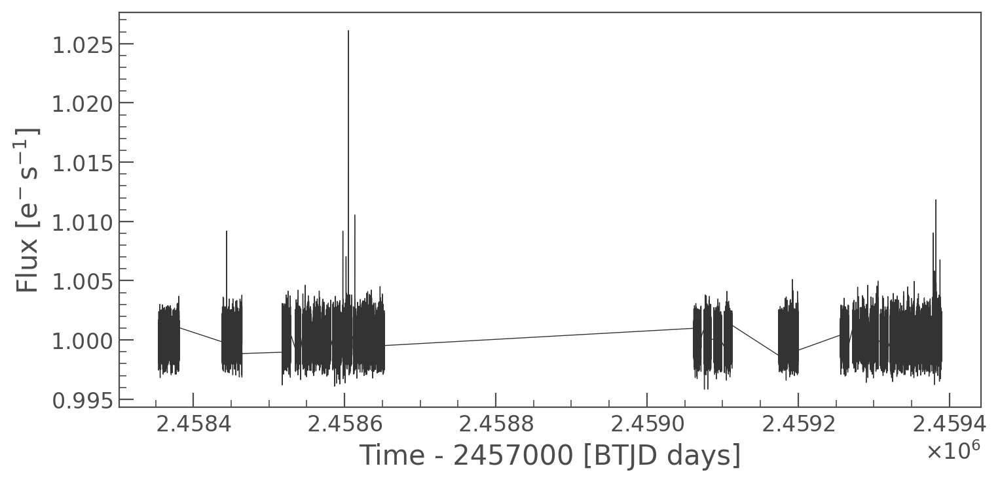

In [17]:
clc.plot()

In [58]:
obs.fit_transit(x_suppl=clc.time.value,
                y_suppl=clc.flux.value,
                yerr_suppl=clc.flux_err.value * 0.2,
                exptime_suppl=np.median(np.diff(clc.time.value)), fit_t0=False, fit_period=False, calc_eclipse=False, ttvs=True)

optimizing logp for variables: [y_supplmean, u_suppl, r_suppl, b, r, r_star, u]


message: Desired error not necessarily achieved due to precision loss.
logp: -981182.2751488799 -> -855337.7777923763
optimizing logp for variables: [r_suppl, tts_d, tts_c, tts_b, b, r, m_star, r_star, u, u_suppl, y_supplmean]


message: Desired error not necessarily achieved due to precision loss.
logp: -855337.7777923763 -> -844364.9987789341


In [59]:
import pymc3_ext as pmx

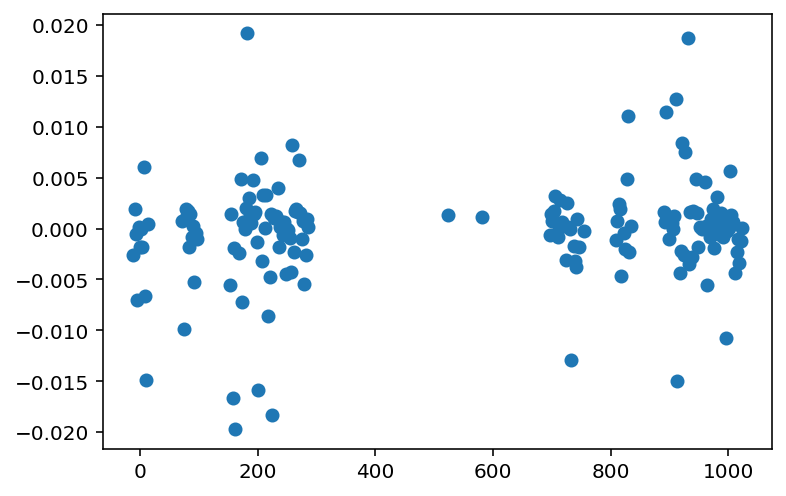

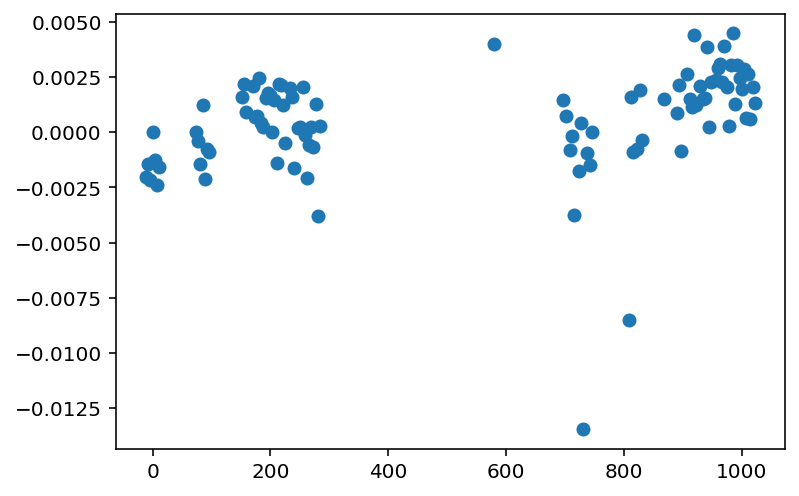

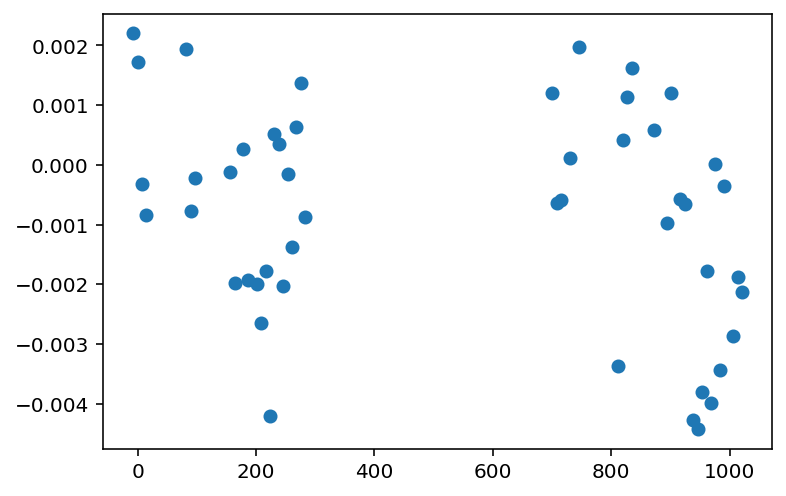

In [60]:
for letter in obs.letter:
    plt.figure()
    orig_t0s = pmx.eval_in_model(getattr(obs._pymc3_model, f'tts_{letter}'), model=obs._pymc3_model, point=obs._pymc3_model.test_point)
    plt.scatter(orig_t0s, orig_t0s - obs.map_soln[f'tts_{letter}'])

In [61]:
mlc = clc.copy()
mlc.flux = obs.map_soln['transit_suppl'] + obs.map_soln['y_supplmean']

/Users/ch/Library/Caches/pypoetry/virtualenvs/ombre-vf38qw1p-py3.8/lib/python3.8/site-packages/lightkurve/lightcurve.py:943: LightkurveWarning: `epoch_time` appears to be given in JD, however the light curve time uses BTJD (i.e. JD - 2457000).
  warnings.warn(
/Users/ch/Library/Caches/pypoetry/virtualenvs/ombre-vf38qw1p-py3.8/lib/python3.8/site-packages/lightkurve/lightcurve.py:943: LightkurveWarning: `epoch_time` appears to be given in JD, however the light curve time uses BTJD (i.e. JD - 2457000).
  warnings.warn(
/Users/ch/Library/Caches/pypoetry/virtualenvs/ombre-vf38qw1p-py3.8/lib/python3.8/site-packages/lightkurve/lightcurve.py:943: LightkurveWarning: `epoch_time` appears to be given in JD, however the light curve time uses BTJD (i.e. JD - 2457000).
  warnings.warn(
/Users/ch/Library/Caches/pypoetry/virtualenvs/ombre-vf38qw1p-py3.8/lib/python3.8/site-packages/lightkurve/lightcurve.py:943: LightkurveWarning: `epoch_time` appears to be given in JD, however the light curve time uses

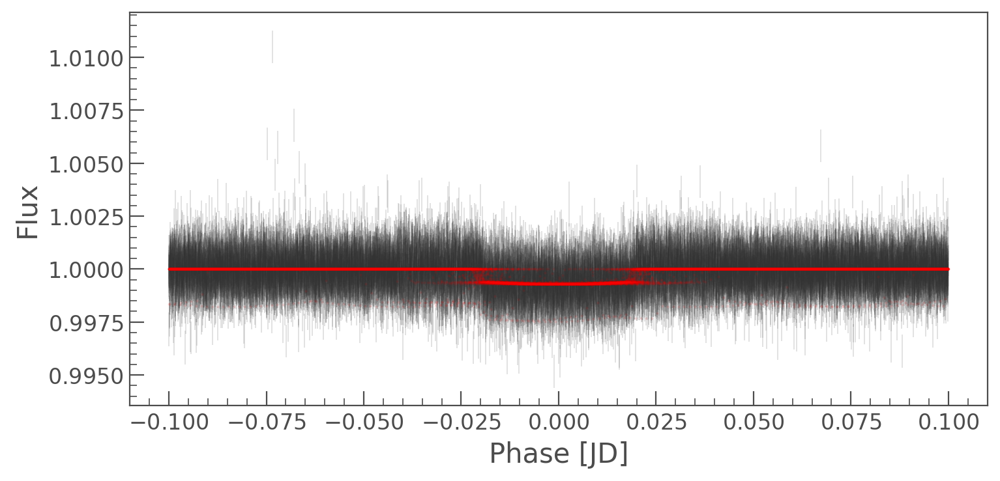

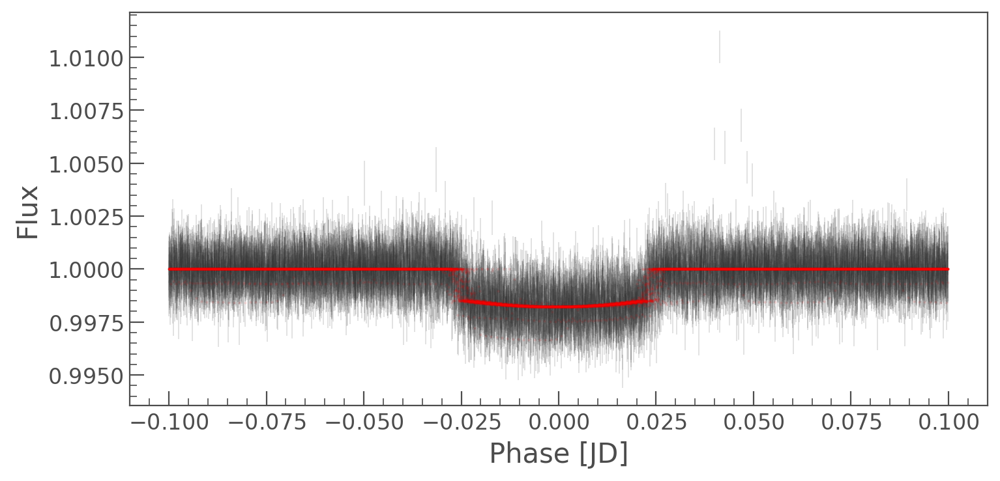

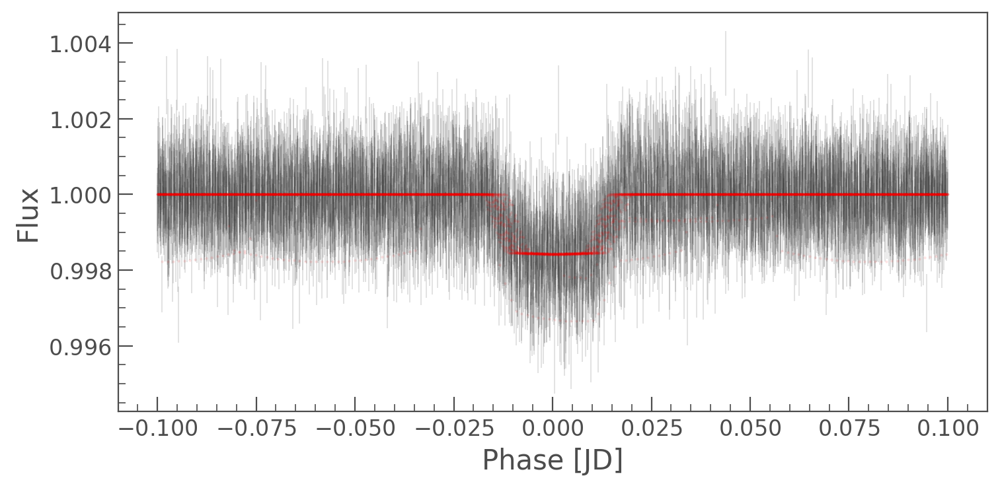

In [62]:
for p, t0 in zip(obs.period, obs.t0):
    f = clc.fold(p, t0)
    k = np.abs(f.phase.value) < 0.1
    ax = f[k].errorbar(ls='', lw=0.1, zorder=-10)
    mlc.fold(p, t0)[k].scatter(ax=ax, c='r', s=1, zorder=10, alpha=0.1)

array([<AxesSubplot:title={'center':'L-98-59 b'}, xlabel='Phase', ylabel='Normalized Flux'>,
       <AxesSubplot:title={'center':'L-98-59 c'}, xlabel='Phase', ylabel='Normalized Flux'>,
       <AxesSubplot:title={'center':'L-98-59 d'}, xlabel='Phase', ylabel='Normalized Flux'>],
      dtype=object)

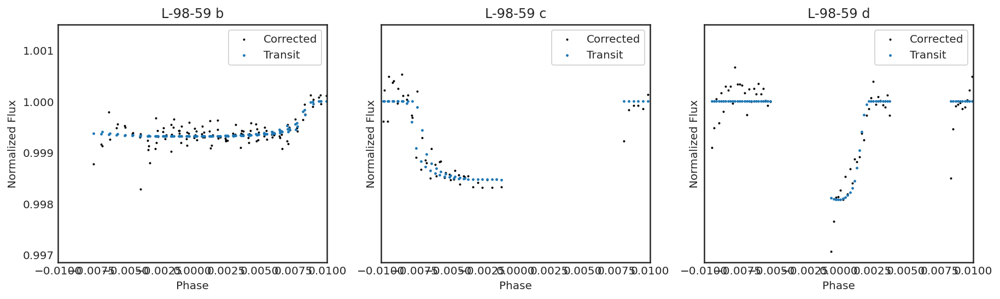

In [63]:
obs.plot(xlim=(-0.01, 0.01))

In [96]:
visit = obs[0]

<AxesSubplot:title={'center':'L-98-59d Transmission Spectrum, Visit: 4'}, xlabel='Wavelength', ylabel='$\\delta$ Transit Depth [ppm]'>

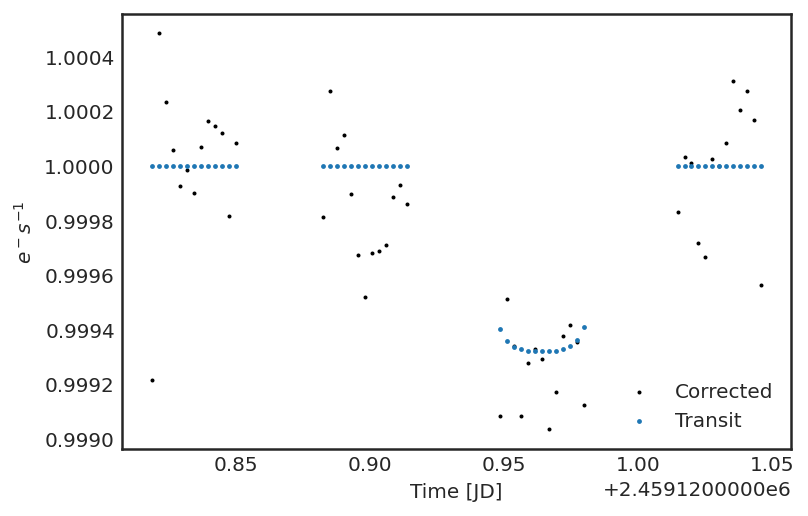

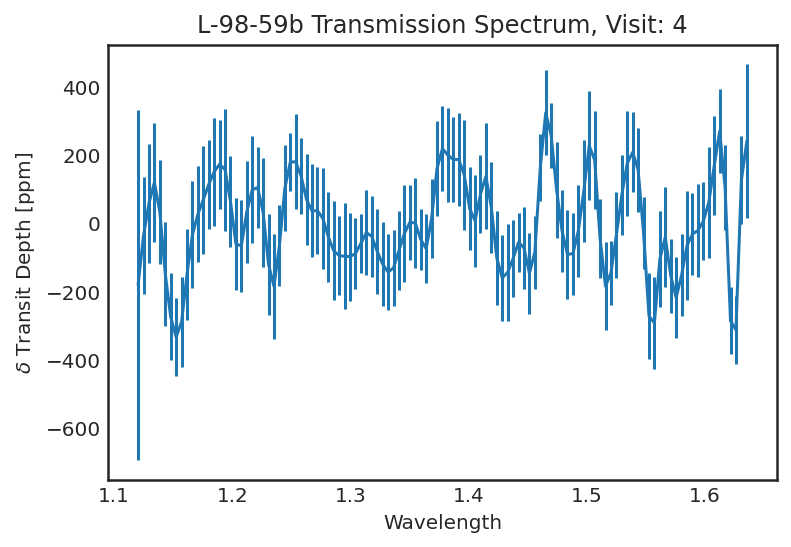

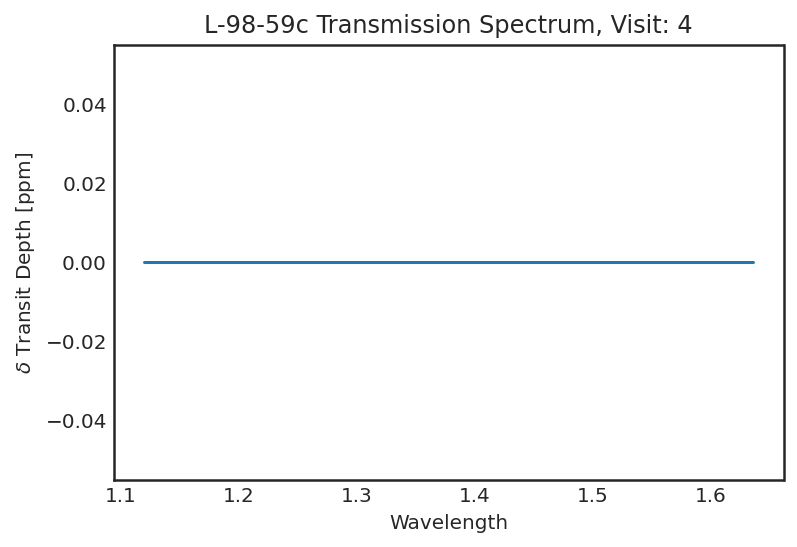

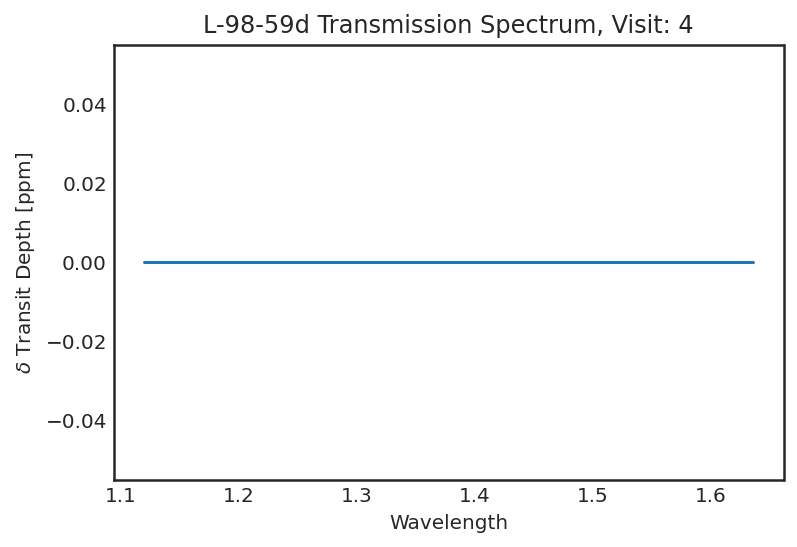

In [94]:
visit.plot()
visit.transmission_spectrum['b'].plot()
visit.transmission_spectrum['c'].plot()
visit.transmission_spectrum['d'].plot()

In [124]:
obs.fit_model(spline=False)

Fitting Transit/Eclipse Model:   7%|███                                       | 1/14 [00:43<09:22, 43.28s/it]

KeyboardInterrupt: 

In [ ]:
fig = plt.figure(figsize=(20, 5*len(obs)), facecolor='white')

for idx, visit in enumerate(obs): 
    ax = plt.subplot2grid((len(obs), obs.nplanets + 1), (idx, 0))
    if idx != len(obs) - 1:
        ax.set(xlabel='')
    visit.plot(ax=ax)
    for jdx, letter in enumerate(obs.letter):
        ax = plt.subplot2grid((len(obs), obs.nplanets + 1), (idx, jdx+1))
        visit.transmission_spectrum[letter].plot(ax=ax)
        if idx != len(obs) - 1:
            ax.set(xlabel='')
        if jdx != 0:
            ax.set(ylabel='')
plt.savefig('/Users/ch/Downloads/for_tom.png', dpi=150)

In [ ]:
for letter in obs.letter:
    om.Spectra([visit.transmission_spectrum[letter] for visit in obs if visit.transmission_spectrum[letter].spec.sum().value != 0]).flatten().bin(np.linspace(1.1, 1.7, 200)).plot()

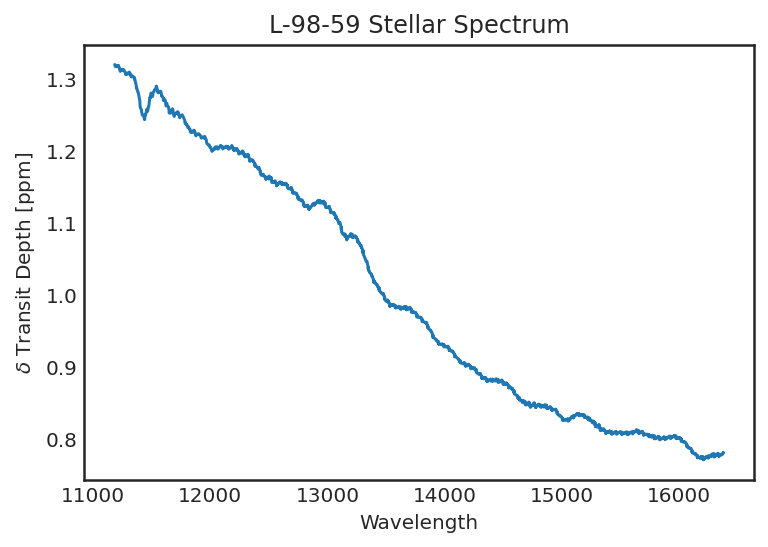

In [100]:
spec = obs.stellar_spectra
spec.plot()
spec.hdulist.writeto(f'results/L98-59_stellar_spectrum.fits', overwrite=True)

In [101]:
# from astropy.io import fits
# try:
#     hdulist = om.Spectra([visit.transmission_spectrum for visit in obs if visit.transmission_spectrum.spec.sum() != 0]).hdulist
#     hdulist.writeto(f'results/{name}_transmission.fits')
# except:
#     pass
# try:    
#     hdulist = om.Spectra([visit.emission_spectrum for visit in obs if visit.emission_spectrum.spec.sum() != 0]).hdulist
#     hdulist.writeto(f'results/{name}_emission.fits')
# except:
#     pass

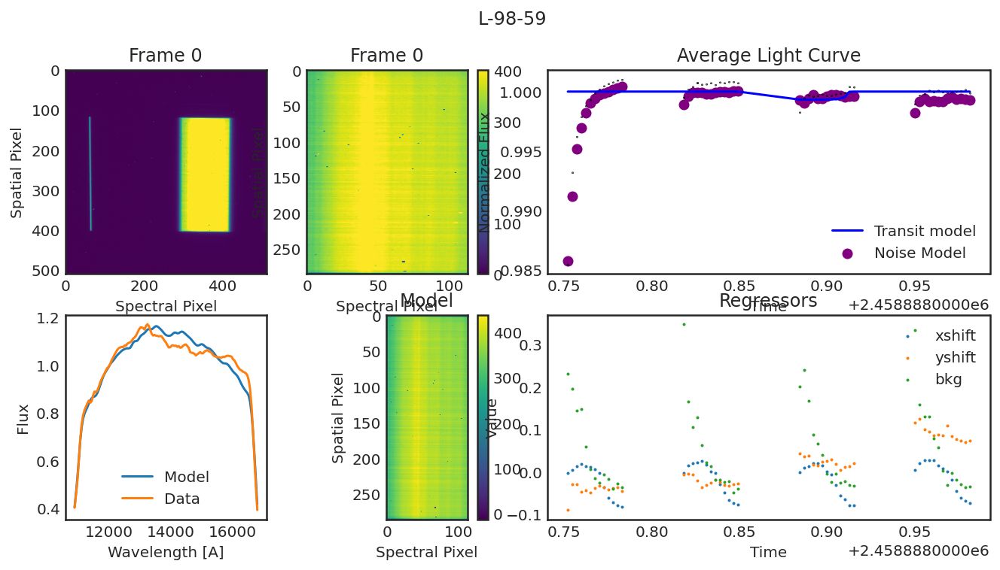

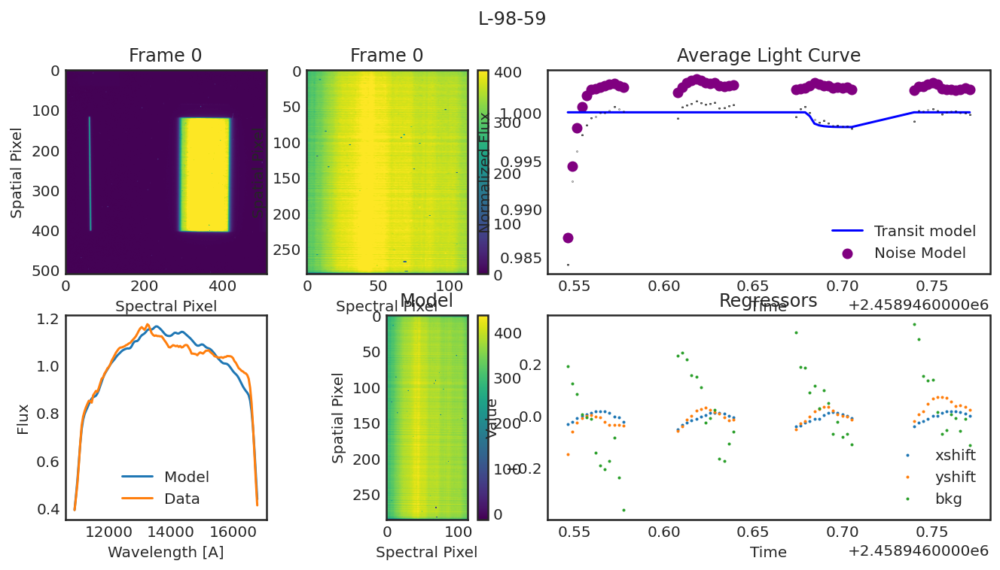

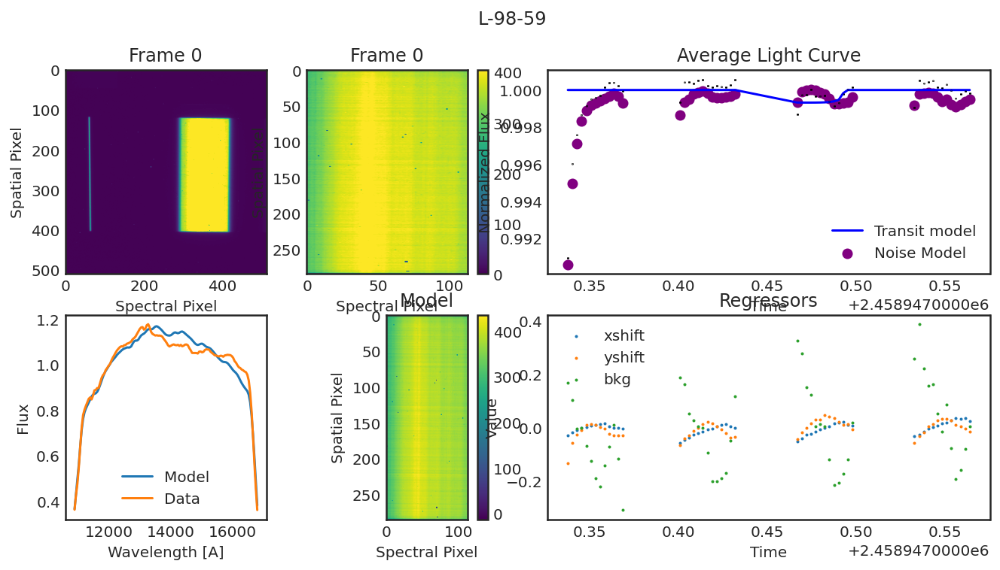

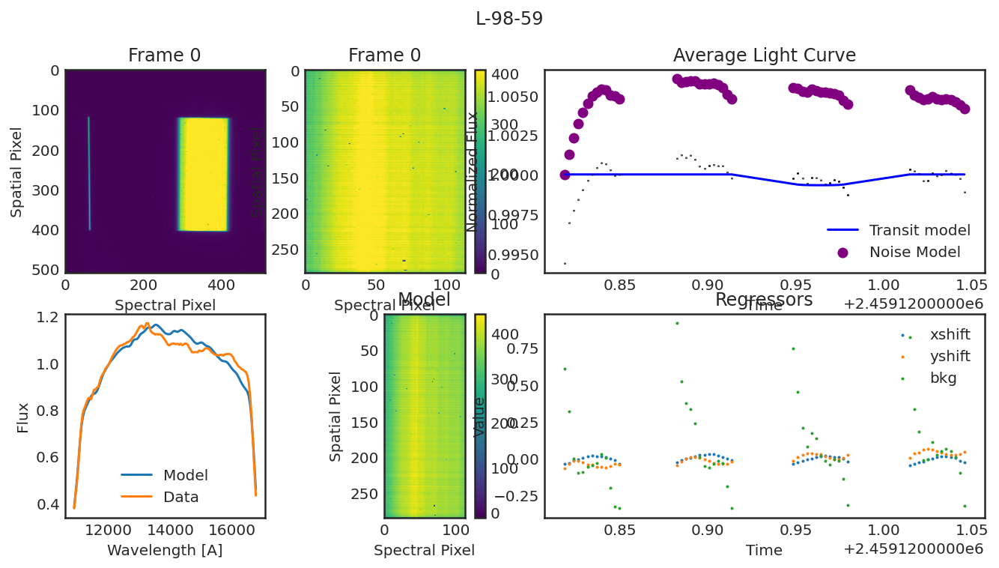

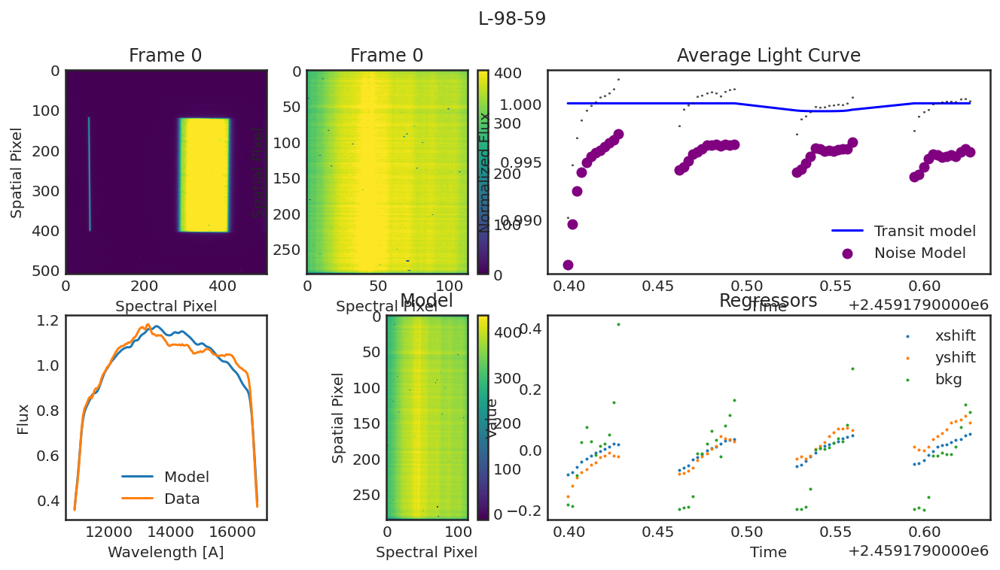

...

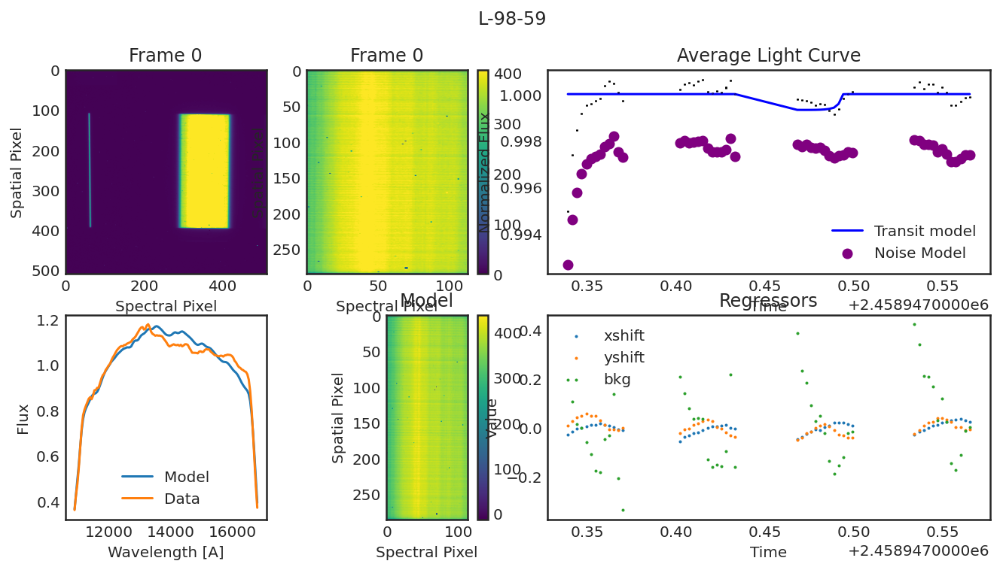

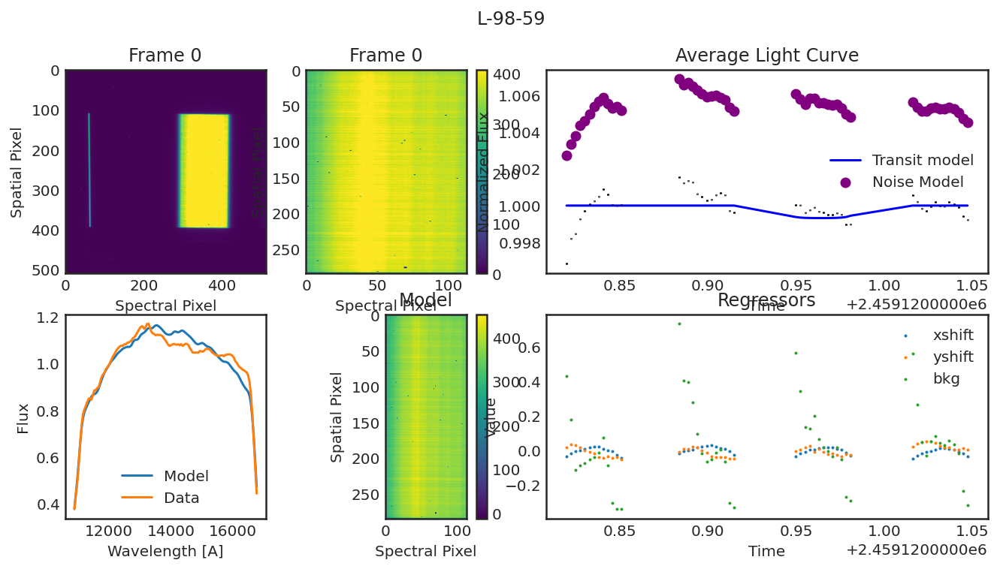

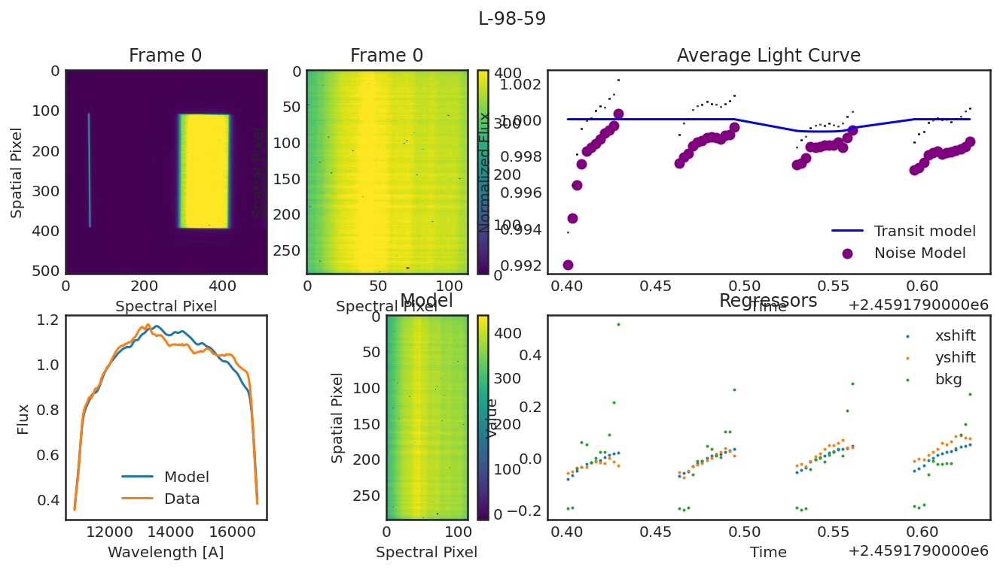

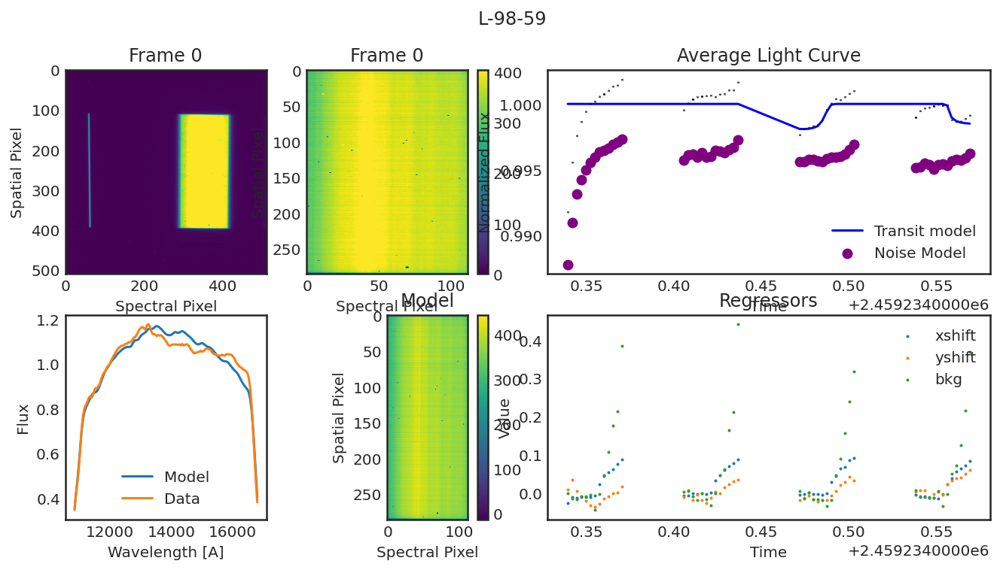

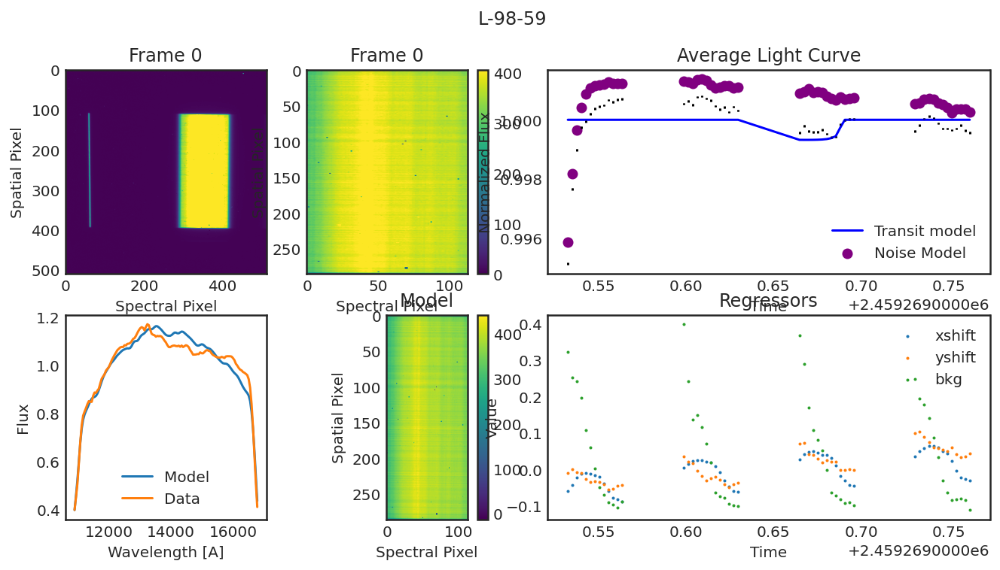

In [102]:
for visit in obs:
    visit.diagnose();
    plt.show();

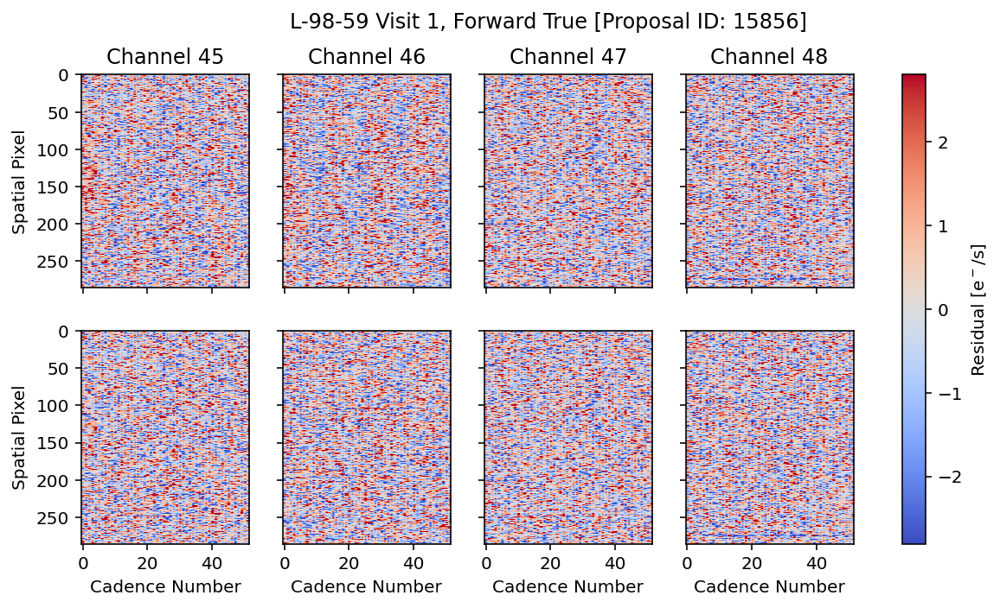

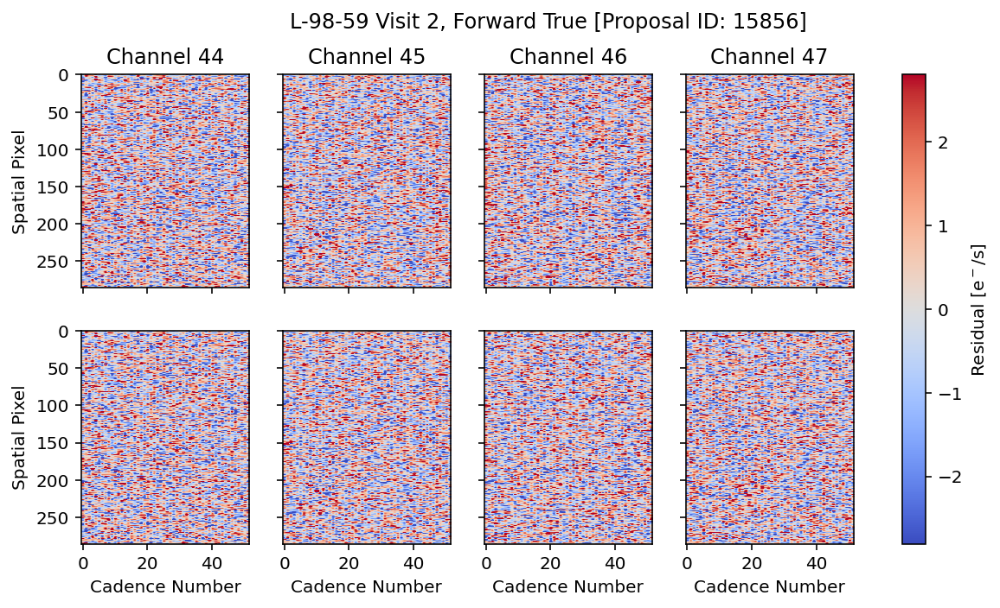

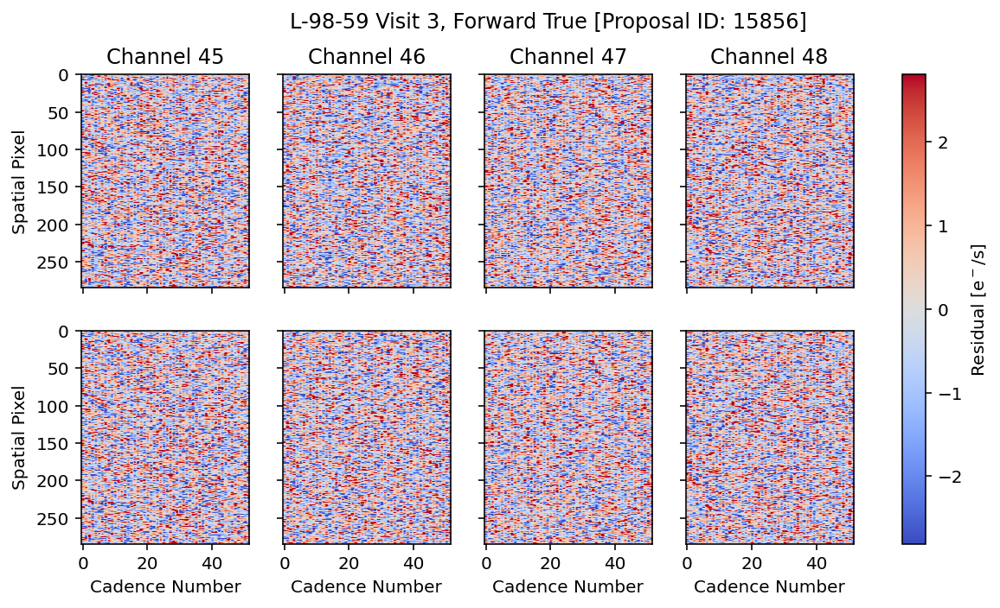

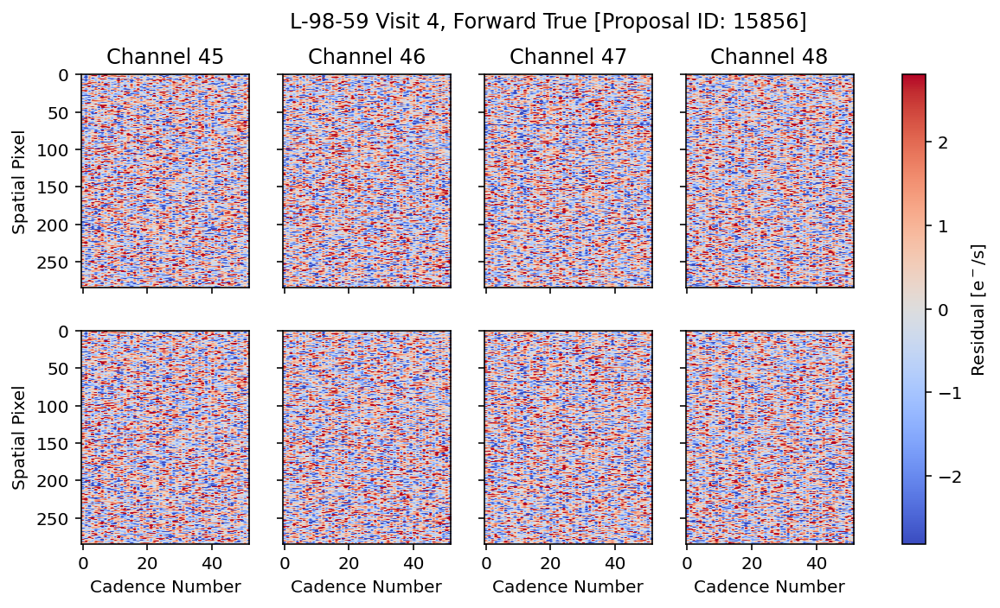

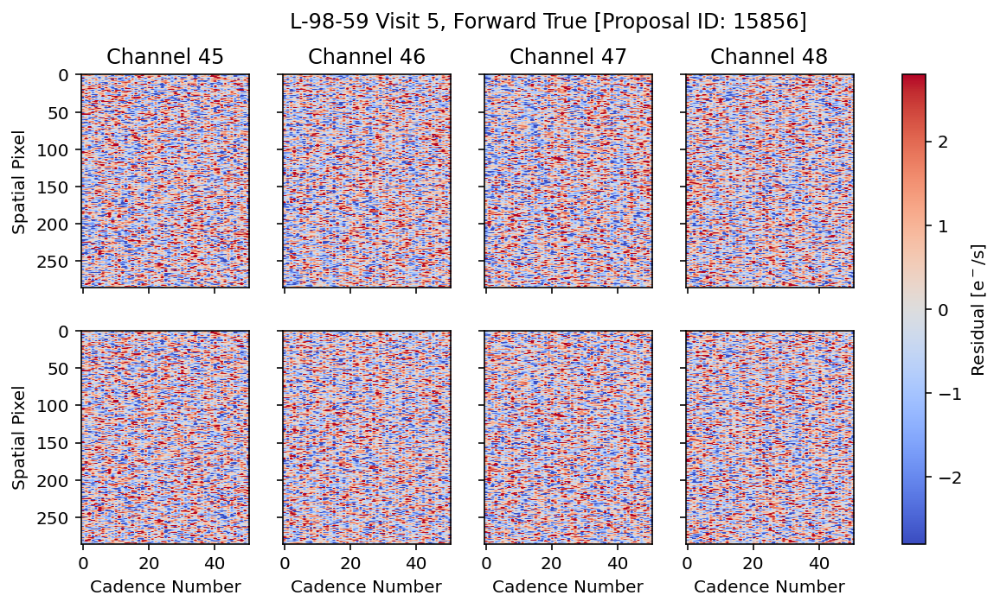

...

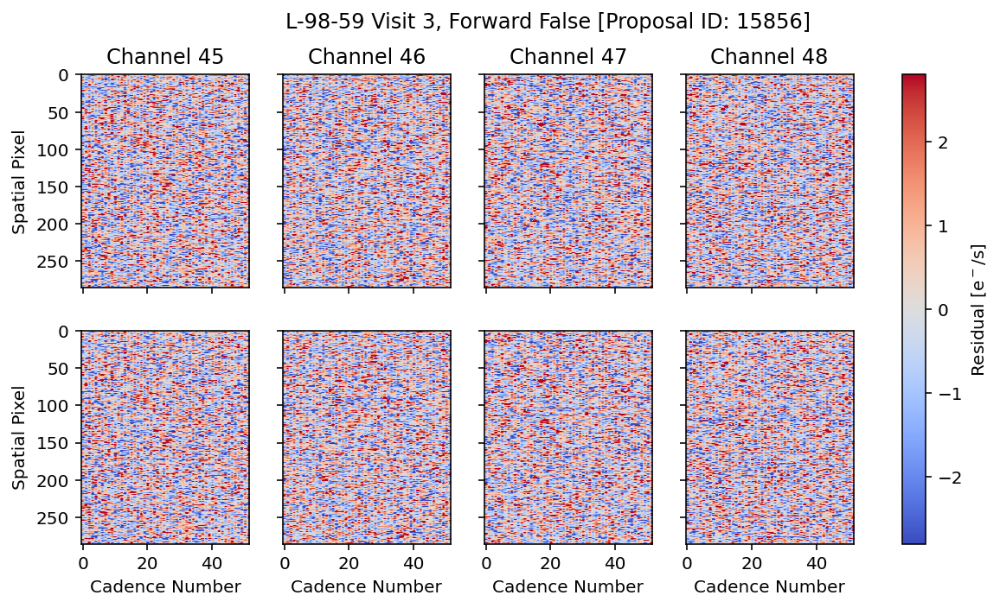

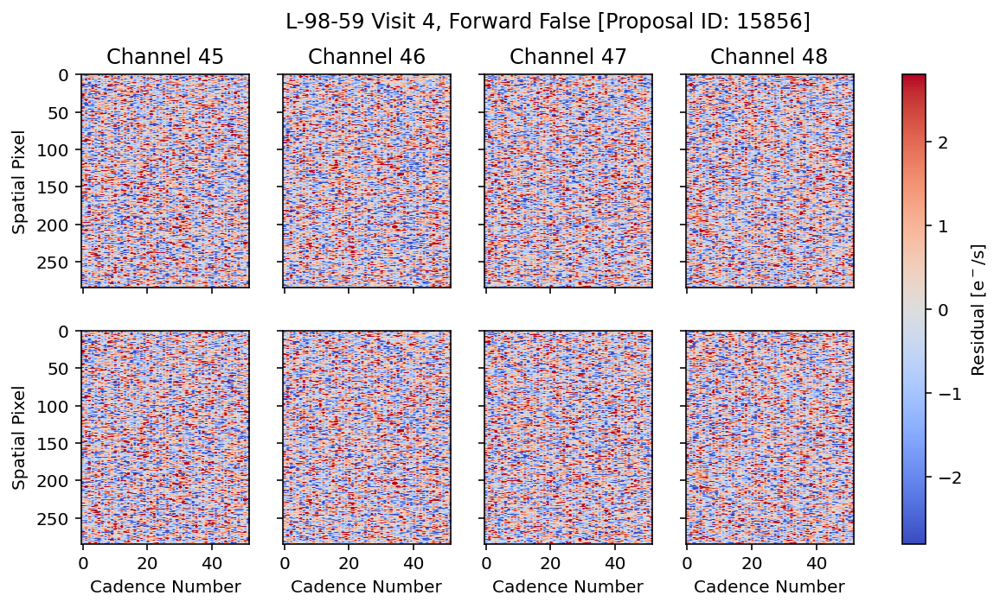

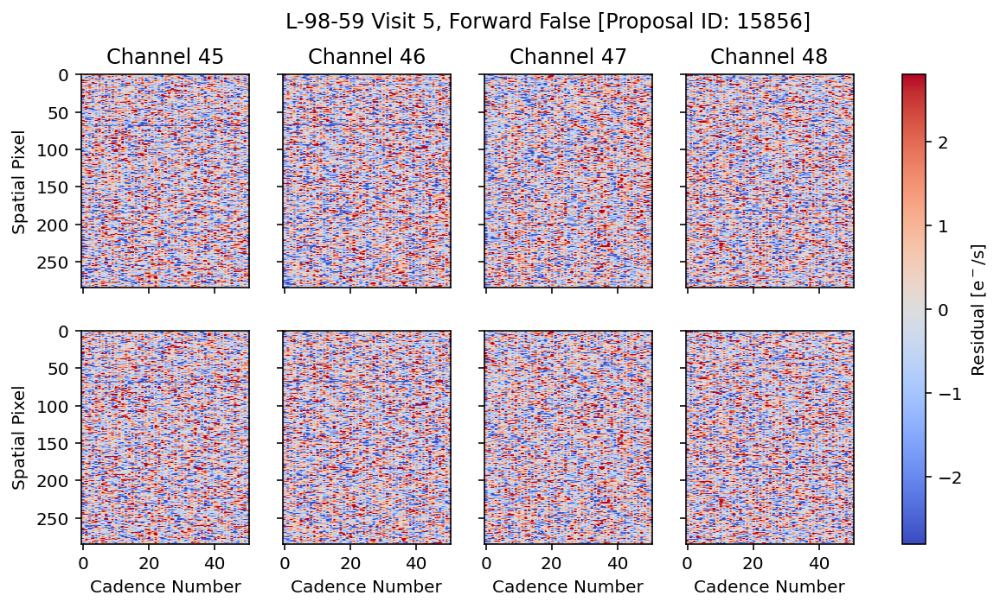

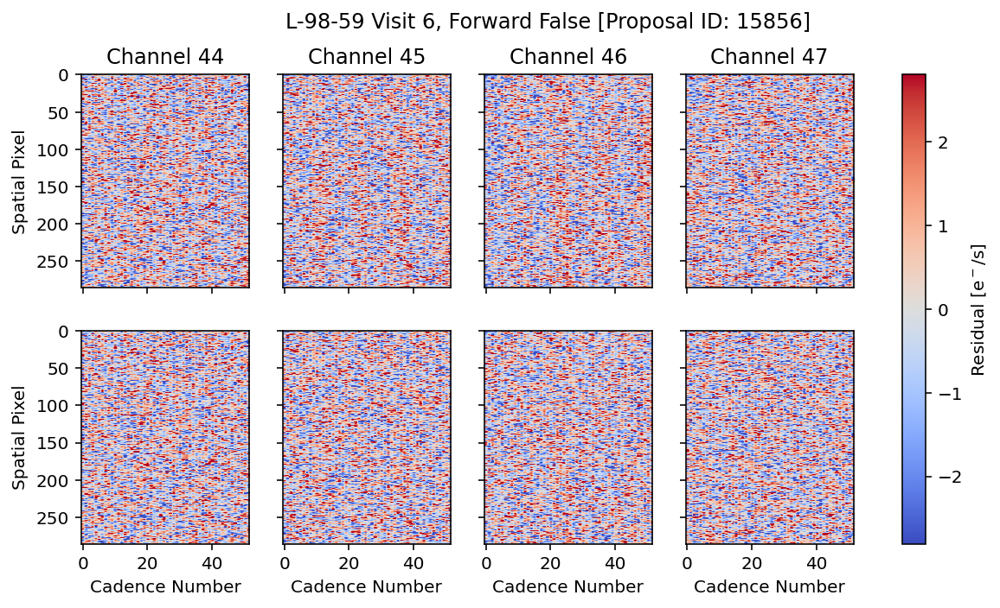

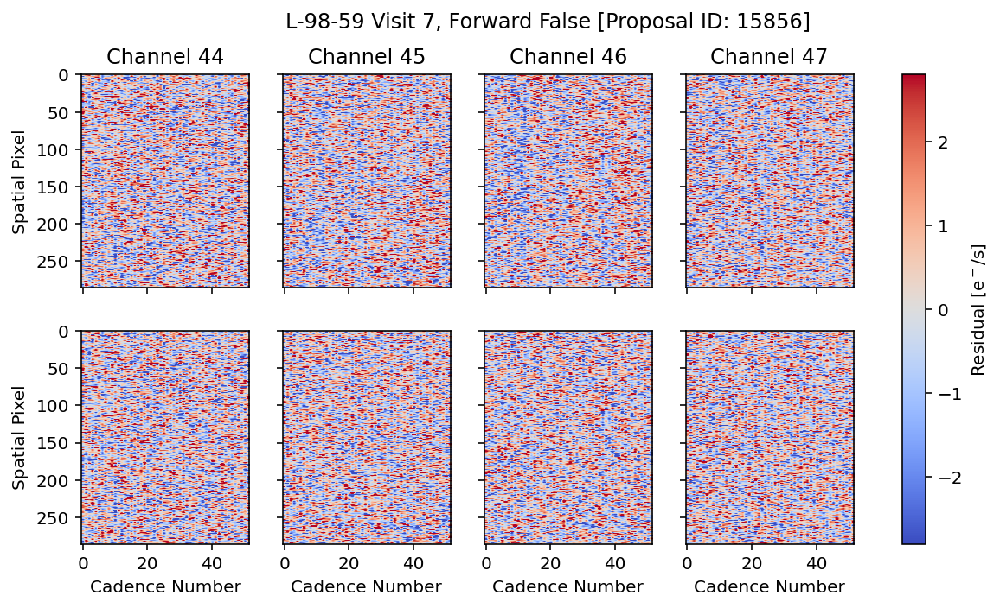

In [103]:
for visit in obs:
    visit.plot_residual_panel();
    plt.show();

In [18]:
import aesara_theano_fallback.tensor as tt
import pymc3 as pm
import pymc3_ext as pmx
import exoplanet as xo

In [19]:
from aesara_theano_fallback import sparse as ttsparse

In [20]:
self = obs

In [21]:
Anames, A = om.matrix.build_noise_matrix(obs[0])

In [22]:
# Visit index
vdx = 0
visit = self[vdx]

In [23]:
x_suppl, x_wl = clc.time.value, self.time
y_suppl, y_wl = clc.flux.value, self.average_lc / np.median(self.average_lc)
y_suppl_err, y_wl_err = clc.flux.value, self.average_lc_err / np.median(self.average_lc)

In [99]:
data = (visit.data / visit.model) / visit.average_lc[:, None, None]
error = (visit.error / visit.model) / visit.average_lc[:, None, None]
error[error > 1e5] = np.inf
weights = np.asarray([visit.error[:, idx::4, :][:, :int(np.floor(visit.nsp / 4)), :] for idx in range(4)])
avg = np.average([data[:, idx::4, :][:, :int(np.floor(visit.nsp / 4)), :] for idx in range(4)], weights=1/weights, axis=0)
#error = np.sum([visit.error[:, idx::4, :][:, :int(np.floor(visit.nsp / 4)), :]**2 for idx in range(4)], axis=0)**0.5
#error = np.average((np.asarray([data[:, idx::4, :][:, :int(np.floor(visit.nsp / 4)), :] for idx in range(4)]) - avg)**2, weights=weights, axis=0)

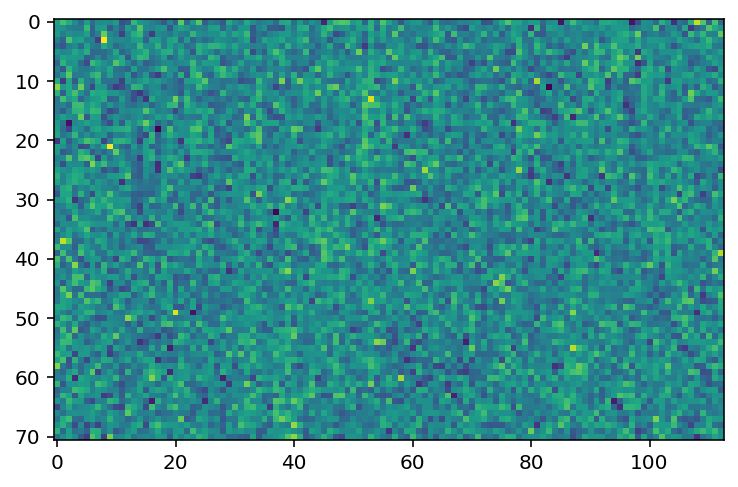

In [104]:
plt.imshow(avg[0])

In [105]:
y = ((visit.data / visit.model) / visit.average_lc[:, None, None]).transpose([2, 0, 1]).ravel()
yerr = ((visit.error / visit.model) / visit.average_lc[:, None, None]).transpose([2, 0, 1]).ravel()

In [106]:
A_tt = ttsparse.basic.CSR(data=A.data, indices=A.indices, indptr=A.indptr, shape=A.shape)

In [121]:
with pm.Model() as model:
    y_supplmean = pm.Normal("y_supplmean", mu=1, sd=0.01, testval=1)
    u_suppl = xo.distributions.QuadLimbDark("u_suppl", testval=np.array([0.4412, 0.2312]))
    u = xo.distributions.QuadLimbDark("u", testval=np.array([0.4412, 0.2312]))
    r_star_pm = pm.Normal(
                "r_star", mu=self.st_rad, sigma=0.2 * self.st_rad, testval=self.st_rad
            )
    m_star_pm = pm.Normal(
        "m_star", mu=self.st_mass, sigma=0.2 * self.st_mass, testval=self.st_mass
            )
    r = pm.Uniform(
                "r",
                lower=self.radius * 0.1,
                upper=self.radius * 10,
                testval=self.radius,
                shape=visit.nplanets,
            )
    ror = pm.Deterministic("ror", r / r_star_pm)
    b = xo.ImpactParameter("b", ror=ror, shape=visit.nplanets)
    orbit = xo.orbits.KeplerianOrbit(
                    period=self.period, t0=self.t0, r_star=r_star_pm, m_star=m_star_pm, b=b
                )
    transit_wl = xo.LimbDarkLightCurve(u).get_light_curve(
                    orbit=orbit, r=r, t=x_wl, texp=np.median(np.diff(x_wl))
                )
    transit_suppl = xo.LimbDarkLightCurve(u_suppl).get_light_curve(
                    orbit=orbit, r=r, t=x_suppl, texp=np.median(np.diff(x_suppl))
                )
    sigma_w_inv = tt.dot(self.A.T, self.A / y_wl_err[:, None] ** 2)
    B = tt.dot(self.A.T, (y_wl / (pm.math.sum(transit_wl, axis=-1) + 1)) / y_wl_err ** 2)
    noise_model_wl = tt.dot(self.A, tt.slinalg.solve(sigma_w_inv, B))
    model_wl = (pm.math.sum(transit_wl, axis=-1) + 1) * noise_model_wl
    model_suppl = pm.math.sum(transit_suppl, axis=-1) + y_supplmean
    
    ts = pm.Normal("ts", mu=0, sigma=1000, testval=0, shape=(visit.nplanets, visit.nwav))
    transit_subtime = xo.LimbDarkLightCurve([0, 0]).get_light_curve(
                    orbit=orbit, r=r, t=(visit._subtime[:, :, None] * np.ones(visit.T.shape)).transpose([2, 0, 1]).ravel(), texp=np.median(np.diff(x_wl))
                ).reshape((visit.nwav, visit.nt, visit.nsp, visit.nplanets)).transpose([3, 1, 2, 0])
    A_transit = ttsparse.basic.csr_from_dense((ts[:, None, None, :] * transit_subtime).reshape((visit.nplanets, visit.nt * visit.nsp * visit.nwav)).T)
    A_all = ttsparse.basic.hstack([A_transit, A_tt])
    

    prior_sigma = ttsparse.basic.csr_from_dense(tt.as_tensor(np.diag(np.ones(A.shape[1] + visit.nplanets) * (1/100000**2))))
    sigma_w_inv = A_all.T.dot(ttsparse.basic.row_scale(A_all, tt.as_tensor(1 / yerr ** 2))) + prior_sigma
    B = A_all.T.dot(tt.as_tensor((y / (yerr ** 2))[:, None]))[:, 0]
    pixel_model_w = tt.slinalg.solve(ttsparse.basic.dense_from_sparse(sigma_w_inv), B)
    pm.Normal("obs_wl",
                mu=tt.concatenate([model_suppl, model_wl]),
                sigma=tt.concatenate([y_suppl_err, y_wl_err]),
                observed=(tt.concatenate([y_suppl, y_wl])),
            )

    map_soln = pmx.optimize(start=model.test_point, verbose=True)

In [122]:
map_soln

{'y_supplmean': array(1.00000355),
 'u_suppl_quadlimbdark__': array([-1.93216313e-05,  9.39444199e-06]),
 'u_quadlimbdark__': array([-5.57314703, -1.01158792]),
 'r_star': array(0.30150849),
 'm_star': array(0.2731062),
 'r_interval__': array([-2.29833636]),
 'b_impact__': array([0.64359076]),
 'u_suppl': array([ 7.07106687e-01, -3.32142078e-06]),
 'u': array([0.03280848, 0.02870683]),
 'r': array([0.00781984]),
 'ror': array([0.02593573]),
 'b': array([0.67256725])}

In [123]:
transit_subtime = pmx.eval_in_model(transit_subtime, model=model, point=map_soln)

KeyError: 'ts'

In [119]:
transit_subtime

array([[[[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        ...,

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
    

In [510]:
pmx.eval_in_model(A_all, model=model, point=map_soln)

<1680536x1587 sparse matrix of type '<class 'numpy.float64'>'
	with 26679796 stored elements in Compressed Sparse Column format>

In [507]:
pixel_model_w

array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
       -1.96932108e-03,  1.48131017e-05, -1.54509140e-04])

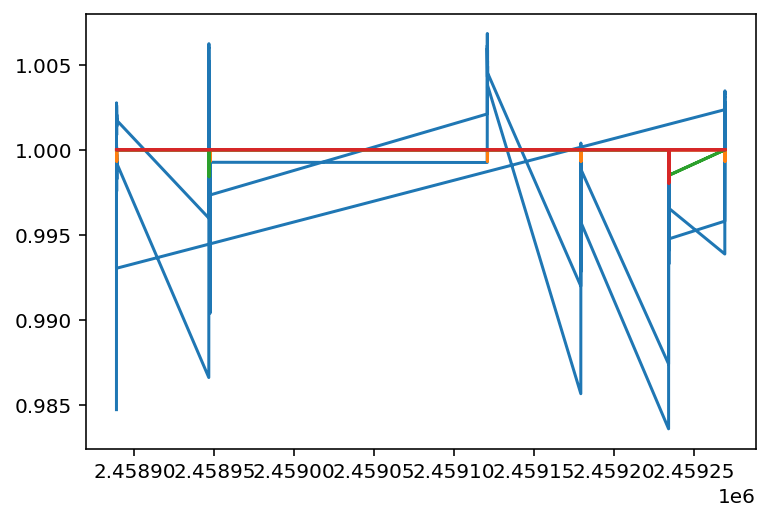

In [496]:
plt.plot(x_wl, y_wl)
plt.plot(x_wl, transit_wl + 1)

In [480]:
m = A.dot(pixel_model_w[:-3]).reshape((visit.nwav, visit.nt, visit.nsp)).transpose([1, 2, 0])

In [404]:
m = A_transit.sum(axis=-1).reshape((visit.nt, visit.nsp, visit.nwav))

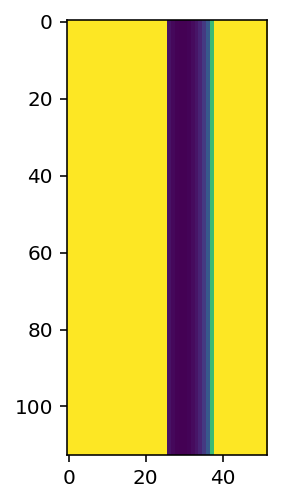

In [405]:
plt.imshow(m.sum(axis=1).T)

In [329]:
transit_subtime.shape

(3, 52, 286, 113)

In [283]:
map_soln

{'y_supplmean': array(1.),
 'u_suppl_quadlimbdark__': array([-0.19210155, -0.7168885 ]),
 'u_quadlimbdark__': array([-0.19210155, -0.7168885 ]),
 'r_star': array(0.3),
 'm_star': array(0.27),
 'r_interval__': array([-2.30258509, -2.30258509, -2.30258509]),
 'b_impact__': array([-0.05064689, -0.08125751, -0.0888918 ])}

In [280]:
y.transpose([2, 0, 1]).ravel().shape

(1680536,)

In [ ]:
map_soln

In [ ]:
plt.scatter(x_wl % self.period[0], y_wl, s=0.1)
plt.scatter(x_wl % self.period[0], pmx.eval_in_model(model_wl, model=model, point=map_soln), c='r', s=0.1)

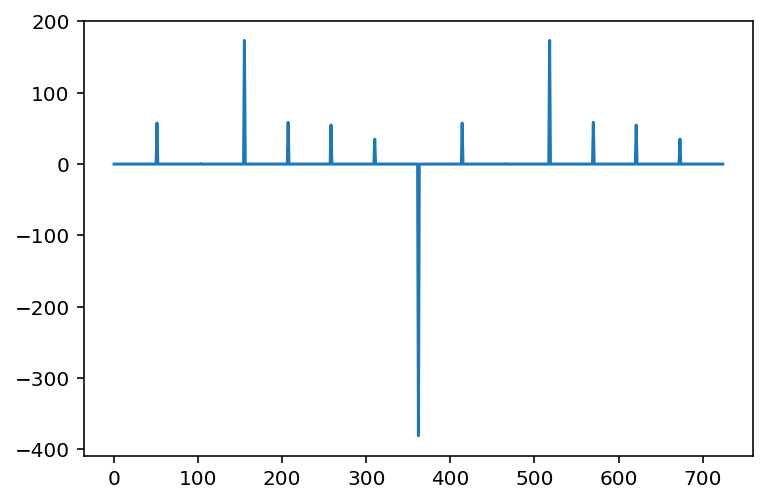

In [210]:
plt.plot(np.diff(x_wl))